In [1]:
pip install ipynbcompress

Note: you may need to restart the kernel to use updated packages.


In [2]:
import warnings
warnings.filterwarnings("ignore")
import json
import pandas as pd
df = pd.read_csv("C://Users//sachi//Downloads//Hotel_Reviews.csv")
df.head()

,Hotel_Address,Additional_Number_of_Scoring,Review_Date,Average_Score,Hotel_Name,Reviewer_Nationality,Negative_Review,Review_Total_Negative_Word_Counts,Total_Number_of_Reviews,Positive_Review,Review_Total_Positive_Word_Counts,Total_Number_of_Reviews_Reviewer_Has_Given,Reviewer_Score,Tags,days_since_review,lat,lng
0,s Gravesandestraat 55 Oost 1092 AA Amsterdam ...,194,8/3/2017,7.7,Hotel Arena,Russia,I am so angry that i made this post available...,397,1403,Only the park outside of the hotel was beauti...,11,7,2.9,"[' Leisure trip ', ' Couple ', ' Duplex Double...",0 days,52.360576,4.915968
1,s Gravesandestraat 55 Oost 1092 AA Amsterdam ...,194,8/3/2017,7.7,Hotel Arena,Ireland,No Negative,0,1403,No real complaints the hotel was great great ...,105,7,7.5,"[' Leisure trip ', ' Couple ', ' Duplex Double...",0 days,52.360576,4.915968
2,s Gravesandestraat 55 Oost 1092 AA Amsterdam ...,194,7/31/2017,7.7,Hotel Arena,Australia,Rooms are nice but for elderly a bit difficul...,42,1403,Location was good and staff were ok It is cut...,21,9,7.1,"[' Leisure trip ', ' Family with young childre...",3 days,52.360576,4.915968
3,s Gravesandestraat 55 Oost 1092 AA Amsterdam ...,194,7/31/2017,7.7,Hotel Arena,United Kingdom,My room was dirty and I was afraid to walk ba...,210,1403,Great location in nice surroundings the bar a...,26,1,3.8,"[' Leisure trip ', ' Solo traveler ', ' Duplex...",3 days,52.360576,4.915968
4,s Gravesandestraat 55 Oost 1092 AA Amsterdam ...,194,7/24/2017,7.7,Hotel Arena,New Zealand,You When I booked with your company on line y...,140,1403,Amazing location and building Romantic setting,8,3,6.7,"[' Leisure trip ', ' Couple ', ' Suite ', ' St...",10 days,52.360576,4.915968


In [3]:
print("Hotel Reviews data set dimensions : {}".format(df.shape))

Hotel Reviews data set dimensions : (515738, 17)


In [4]:
# Imports
import matplotlib.pyplot as plt
import seaborn as sns
color = sns.color_palette()
%matplotlib inline
import plotly.offline as py
py.init_notebook_mode(connected=True)
import plotly.graph_objs as go
import plotly.tools as tls
import plotly.express as px
# Product Scores
fig = px.histogram(df, x="Reviewer_Score")
fig.update_traces(marker_color="turquoise",marker_line_color='rgb(8,48,107)',
                  marker_line_width=1.5)
fig.update_layout(title_text='Reviewer_Score')
fig.show()

In [5]:
!pip install wordcloud

In [6]:
import nltk
from nltk.corpus import stopwords
from wordcloud import WordCloud
# Create stopword list:
stopwords = nltk.corpus.stopwords.words('english')

In [7]:
# assign reviews with score > 3 as positive sentiment
# score < 5 negative sentiment
# remove score = 3
#df = df[df['Score'] != 3]
df["reviews"] = df["Negative_Review"] + df["Positive_Review"]
df['sentiment'] = df['Reviewer_Score'].apply(lambda rating : +1 if rating > 5 else -1)

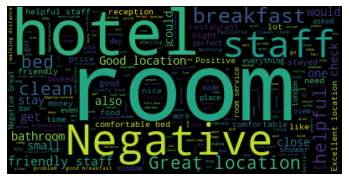

In [8]:
textt = " ".join(review for review in df["reviews"])
wordcloud = WordCloud(stopwords=stopwords).generate(textt)
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
plt.savefig('wordcloud11.png')
plt.show()

In [9]:
# split df - positive and negative sentiment:
positive = df[df['sentiment'] == 1]
negative = df[df['sentiment'] == -1]

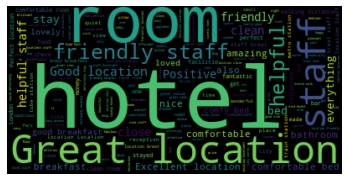

In [10]:
stopwords = nltk.corpus.stopwords.words('english')
pos = " ".join(review for review in positive.Positive_Review)
wordcloud2 = WordCloud(stopwords=stopwords).generate(pos)
plt.imshow(wordcloud2, interpolation='bilinear')
plt.axis("off")
plt.show()

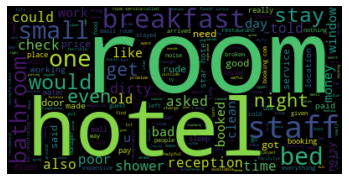

In [11]:
neg = " ".join(review for review in negative.Negative_Review)
wordcloud3 = WordCloud(stopwords=stopwords).generate(neg)
plt.imshow(wordcloud3, interpolation='bilinear')
plt.axis("off")
plt.savefig('wordcloud33.png')
plt.show()

In [12]:
df['sentiment'] = df['sentiment'].replace({-1 : 'negative'})
df['sentiment'] = df['sentiment'].replace({1 : 'positive'})
fig = px.histogram(df, x="sentiment")
fig.update_traces(marker_color="indianred",marker_line_color='rgb(8,48,107)',
                  marker_line_width=1.5)
fig.update_layout(title_text='Hotel Review Sentiment')
fig.show()

In [13]:
def remove_punctuation(text):
    final = "".join(u for u in text if u not in ("?", ".", ";", ":",  "!",'"'))
    return final
#df['reviews'] = df['reviews'].apply(remove_punctuation)
df = df.dropna(subset=['reviews'])
df['reviews'] = df['reviews'].apply(remove_punctuation)

In [14]:
df_rev_sen = df[["reviews", "sentiment"]]

In [15]:
df_rev_sen.head()

,reviews,sentiment
0,I am so angry that i made this post available...,negative
1,No Negative No real complaints the hotel was g...,positive
2,Rooms are nice but for elderly a bit difficul...,positive
3,My room was dirty and I was afraid to walk ba...,negative
4,You When I booked with your company on line y...,positive


In [16]:
import numpy as np
# random split train and test data
index = df.index
df['random_number'] = np.random.randn(len(index))
train = df[df['random_number'] <= 0.8]
test = df[df['random_number'] > 0.8]

In [17]:
# count vectorizer:
from sklearn.feature_extraction.text import CountVectorizer
vectorizer = CountVectorizer(token_pattern=r'\b\w+\b')
train_matrix = vectorizer.fit_transform(train['reviews'])
test_matrix = vectorizer.transform(test['reviews'])

In [18]:
# Logistic Regression
from sklearn.linear_model import LogisticRegression
lr = LogisticRegression(solver='lbfgs', max_iter=1000)

In [19]:
X_train = train_matrix
X_test = test_matrix
y_train = train['sentiment']
y_test = test['sentiment']

In [20]:
lr.fit(X_train,y_train)

LogisticRegression(max_iter=1000)

In [21]:
predictions = lr.predict(X_test)

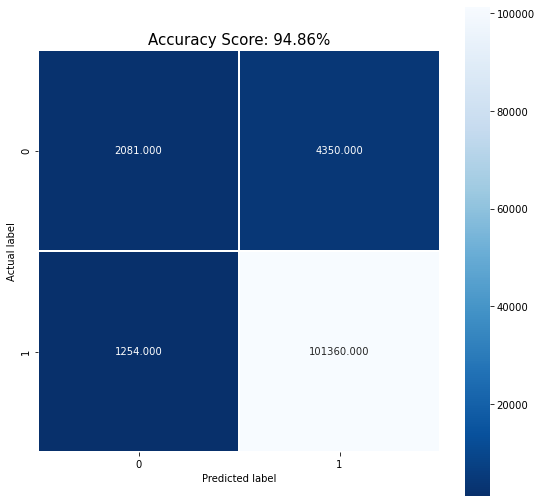

In [23]:
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn import metrics
from sklearn.metrics import confusion_matrix
from sklearn.metrics import accuracy_score, classification_report
confusion_matrix = metrics.confusion_matrix(y_test, lr.predict(X_test))
plt.figure(figsize=(9,9))
sns.heatmap(confusion_matrix, annot=True, fmt=".3f", linewidths=.5, square = True, cmap = 'Blues_r');
plt.ylabel('Actual label');
plt.xlabel('Predicted label');
all_sample_title = 'Accuracy Score: {0:.2f}%'.format(accuracy_score(y_test, lr.predict(X_test))*100.)
plt.title(all_sample_title, size = 15);

In [24]:
score = lr.score(X_test, y_test)
print('Accuracy score ',score)
print('\n')
print('Accuracy score of the Logistic Regression Classifier Using Kernel as Linear {0:.2f}%'
      .format(accuracy_score(y_test, lr.predict(X_test))*100.))
print('\n')

Accuracy score  0.9486083726901737


Accuracy score of the Logistic Regression Classifier Using Kernel as Linear 94.86%




In [ ]:
https://www.kaggle.com/jiashenliu/515k-hotel-reviews-data-in-europe